[![Open In Colab](https://colab.research.google.com/assets/colab-badge.svg)](https://colab.research.google.com/github/marceloprates/prettymaps/blob/master/notebooks/examples.ipynb)

# Installation (restart runtime after running the following cell)

In [1]:
!pip install git+https://github.com/abey79/vsketch#egg=vsketch
!pip install git+https://github.com/marceloprates/prettymaps.git

!mkdir ../prints
!mkdir ../assets
!mkdir ../assets/Permanent_Marker/
!wget -O ../assets/Permanent_Marker/PermanentMarker-Regular.ttf https://github.com/marceloprates/prettymaps/raw/main/assets/Permanent_Marker/PermanentMarker-Regular.ttf

# Imports

In [1]:
# For local execution (does not require installing the library):
%load_ext autoreload
%autoreload 2
import sys; sys.path.append('../')

# Prettymaps
from prettymaps import *
# Vsketch
import vsketch
# OSMNX
import osmnx as ox
# Matplotlib-related
import matplotlib.font_manager as fm
from matplotlib import pyplot as plt
from descartes import PolygonPatch
# Shapely
from shapely.geometry import *
from shapely.affinity import *
from shapely.ops import unary_union

# Macao, China (circle plot)

In [3]:
fig, ax = plt.subplots(figsize = (12, 12), constrained_layout = True)

layers = plot(
    'Praça Ferreira do Amaral, Macau', radius = 1100,
    ax = ax,
    layers = {
            'perimeter': {},
            'streets': {
                'custom_filter': '["highway"~"motorway|trunk|primary|secondary|tertiary|residential|service|unclassified|pedestrian|footway"]',
                'width': {
                    'motorway': 5,
                    'trunk': 5,
                    'primary': 4.5,
                    'secondary': 4,
                    'tertiary': 3.5,
                    'residential': 3,
                    'service': 2,
                    'unclassified': 2,
                    'pedestrian': 2,
                    'footway': 1,
                }
            },
            'building': {'tags': {'building': True, 'landuse': 'construction'}, 'union': False},
            'water': {'tags': {'natural': ['water', 'bay']}},
            'green': {'tags': {'landuse': 'grass', 'natural': ['island', 'wood'], 'leisure': 'park'}},
            'forest': {'tags': {'landuse': 'forest'}},
            'parking': {'tags': {'amenity': 'parking', 'highway': 'pedestrian', 'man_made': 'pier'}}
        },
        drawing_kwargs = {
            'background': {'fc': '#F2F4CB', 'ec': '#dadbc1', 'hatch': 'ooo...', 'zorder': -1},
            'perimeter': {'fc': '#F2F4CB', 'ec': '#dadbc1', 'lw': 0, 'hatch': 'ooo...',  'zorder': 0},
            'green': {'fc': '#D0F1BF', 'ec': '#2F3737', 'lw': 1, 'zorder': 1},
            'forest': {'fc': '#64B96A', 'ec': '#2F3737', 'lw': 1, 'zorder': 1},
            'water': {'fc': '#a1e3ff', 'ec': '#2F3737', 'hatch': 'ooo...', 'hatch_c': '#85c9e6', 'lw': 1, 'zorder': 2},
            'parking': {'fc': '#F2F4CB', 'ec': '#2F3737', 'lw': 1, 'zorder': 3},
            'streets': {'fc': '#2F3737', 'ec': '#475657', 'alpha': 1, 'lw': 0, 'zorder': 3},
            'building': {'palette': ['#FFC857', '#E9724C', '#C5283D'], 'ec': '#2F3737', 'lw': .5, 'zorder': 4},
        },

        osm_credit = {'color': '#2F3737'}
)

#plt.savefig('../prints/macao.png')
#plt.savefig('../prints/macao.svg')

/home/marcelo/anaconda3/envs/prettymaps/lib/python3.9/site-packages/geopandas/_vectorized.py:287: DeprecationWarning: An exception was ignored while fetching the attribute `__array_interface__` from an object of type 'Polygon'.  With the exception of `AttributeError` NumPy will always raise this exception in the future.  Raise this deprecation warning to see the original exception. (Warning added NumPy 1.21)
  data[:] = [
/home/marcelo/anaconda3/envs/prettymaps/lib/python3.9/site-packages/geopandas/_vectorized.py:287: DeprecationWarning: An exception was ignored while fetching the attribute `__array_interface__` from an object of type 'MultiPolygon'.  With the exception of `AttributeError` NumPy will always raise this exception in the future.  Raise this deprecation warning to see the original exception. (Warning added NumPy 1.21)
  data[:] = [
/home/marcelo/anaconda3/envs/prettymaps/lib/python3.9/site-packages/geopandas/_vectorized.py:142: DeprecationWarning: An exception was ignored 

# Barcelona, Spain (square plot with rounded edges)

In [4]:
# Style parameters
palette = ['#433633', '#FF5E5B']
background_c = '#F2F4CB'
dilate = 100

# Setup figure
fig, ax = plt.subplots(figsize = (10, 10), constrained_layout = True)

# Plot
layers = plot(
    (41.39491,2.17557), radius = 500,
    ax = ax,
    layers = {
        'perimeter': {'circle': False, 'dilate': dilate},
        'streets': {
            'width': {
                'primary': 5,
                'secondary': 4,
                'tertiary': 3,
                'residential': 2,
                'footway': 1,
            },
            'circle': False,
            'dilate': dilate
        },
        'building': {
            'tags': {'building': True},
            'union': False,
            'circle': False,
            'dilate': dilate
        },
        'green': {
            'tags': {
                'landuse': ['grass', 'village_green'],
                'leisure': 'park'
            },
            'circle': False,
            'dilate': dilate
        },
    },
    drawing_kwargs = {
        'background': {'fc': '#F2F4CB', 'ec': '#dadbc1', 'hatch': 'ooo...', 'zorder': -1},
        'perimeter': {'fill': False, 'lw': 0, 'zorder': 0},
        'green': {'fc': '#8BB174', 'ec': '#2F3737', 'hatch_c': '#A7C497', 'hatch': 'ooo...', 'lw': 1, 'zorder': 1},
        'water': {'fc': '#a8e1e6', 'ec': '#2F3737', 'hatch_c': '#9bc3d4', 'hatch': 'ooo...', 'lw': 1, 'zorder': 3},
        'streets': {'fc': '#2F3737', 'ec': '#475657', 'alpha': 1, 'lw': 0, 'zorder': 4},
        'building': {'palette': palette, 'ec': '#2F3737', 'lw': .5, 'zorder': 5},
    },
    osm_credit = {'x': .02, 'y': .01, 'color': '#2F3737'}
)

# Set bounds
xmin, ymin, xmax, ymax = layers['perimeter'].bounds
dx, dy = xmax-xmin, ymax-ymin
ax.set_xlim(xmin-.06*dx, xmax+.06*dx)
ax.set_ylim(ymin-.06*dy, ymax+.06*dy)

# Draw left text
ax.text(
    xmin-.06*dx, ymin+.5*dy,
    'Barcelona, Spain',
    color = '#2F3737',
    rotation = 90,
    fontproperties = fm.FontProperties(fname = '../assets/Permanent_Marker/PermanentMarker-Regular.ttf', size = 35),
)
# Draw top text
ax.text(
    xmax-.35*dx, ymax+.02*dy,
    "41° 23′ N, 2° 11′ E",
    color = '#2F3737',
    fontproperties = fm.FontProperties(fname = '../assets/Permanent_Marker/PermanentMarker-Regular.ttf', size = 20),
)

#plt.savefig('../prints/barcelona.png')
#plt.savefig('../prints/barcelona.svg')

/home/marcelo/anaconda3/envs/prettymaps/lib/python3.9/site-packages/geopandas/_vectorized.py:142: DeprecationWarning: An exception was ignored while fetching the attribute `__array_interface__` from an object of type 'MultiPolygon'.  With the exception of `AttributeError` NumPy will always raise this exception in the future.  Raise this deprecation warning to see the original exception. (Warning added NumPy 1.21)
  aout[:] = out
/home/marcelo/anaconda3/envs/prettymaps/lib/python3.9/site-packages/geopandas/_vectorized.py:287: DeprecationWarning: An exception was ignored while fetching the attribute `__array_interface__` from an object of type 'Polygon'.  With the exception of `AttributeError` NumPy will always raise this exception in the future.  Raise this deprecation warning to see the original exception. (Warning added NumPy 1.21)
  data[:] = [
/home/marcelo/anaconda3/envs/prettymaps/lib/python3.9/site-packages/geopandas/_vectorized.py:287: DeprecationWarning: An exception was ignore

Text(431259.3627690353, 4583549.216453441, '41° 23′ N, 2° 11′ E')

/home/marcelo/anaconda3/envs/prettymaps/lib/python3.9/site-packages/matplotlib/textpath.py:65: RuntimeWarning: Glyph 8242 missing from current font.
  font.set_text(s, 0.0, flags=LOAD_NO_HINTING)


# Barcelona, Spain (vsketch mode for pen plotter)

In [5]:
import vsketch

dilate = 100

class Sketch(vsketch.SketchClass):
    def draw(self, vsk: vsketch.Vsketch) -> None:
        
        vsk.size("a4", landscape = True)

        global layers
        layers = plot(
            (41.39491,2.17557), radius = 500,
            vsketch = vsk,
            layers = {
                'perimeter': {'circle': False, 'dilate': dilate},
                'streets': {
                    'width': {
                        'primary': 5,
                        'secondary': 4,
                        'tertiary': 3,
                        'residential': 2,
                        'footway': 1,
                    },
                    'circle': False,
                    'dilate': dilate
                },
                'building': {
                    'tags': {'building': True},
                    'union': False,
                    'circle': False,
                    'dilate': dilate
                },
                'green': {
                    'tags': {
                        'landuse': ['grass', 'village_green'],
                        'leisure': 'park'
                    },
                    'circle': False,
                    'dilate': dilate
                },
            },

            scale_x = .65,
            scale_y = -.65,

            drawing_kwargs = {
                'perimeter': {'draw': False},
                'streets': {'stroke': 1, 'fill': 1, 'penWidth': 2},
                'buildings': {'stroke': 2},
            },
        )

        vsk.save("../prints/barcelona-plotter.svg")

    def finalize(self, vsk: vsketch.Vsketch) -> None:
        vsk.vpype("linemerge linesimplify reloop linesort")

sketch = Sketch()
sketch.display()

/home/marcelo/anaconda3/envs/prettymaps/lib/python3.9/site-packages/geopandas/_vectorized.py:142: DeprecationWarning: An exception was ignored while fetching the attribute `__array_interface__` from an object of type 'MultiPolygon'.  With the exception of `AttributeError` NumPy will always raise this exception in the future.  Raise this deprecation warning to see the original exception. (Warning added NumPy 1.21)
  aout[:] = out
/home/marcelo/anaconda3/envs/prettymaps/lib/python3.9/site-packages/geopandas/_vectorized.py:287: DeprecationWarning: An exception was ignored while fetching the attribute `__array_interface__` from an object of type 'MultiLineString'.  With the exception of `AttributeError` NumPy will always raise this exception in the future.  Raise this deprecation warning to see the original exception. (Warning added NumPy 1.21)
  data[:] = [
/home/marcelo/anaconda3/envs/prettymaps/lib/python3.9/site-packages/geopandas/_vectorized.py:142: DeprecationWarning: An exception wa

<?xml version="1.0" encoding="utf-8" ?>
 
 
 
 
 image/svg+xml 
 
 2021-09-13T17:30:34.039318 
 
 
 
 
 
 <polygon points="798.3271,750.5278 798.2708,750.4979 798.2177,750.4625 798.1683,750.4221 798.1232,750.3771 798.0826,750.3279 798.0471,750.2749 798.0169,750.2187 797.9924,750.1598 797.9738,750.0988 797.9612,750.0362 797.9549,749.9728 797.9548,749.909 797.9609,749.8455 797.9733,749.7829 797.9917,749.7218 798.016,749.6629 798.046,749.6066 798.0813,749.5535 798.1217,749.5041 798.1667,749.4589 798.216,749.4184 798.2689,749.3828 798.3252,749.3527 798.384,749.3282 798.4451,749.3095 798.5076,749.297 798.5711,749.2906 798.6349,749.2905 798.6983,749.2967 798.7609,749.309 798.822,749.3274 798.881,749.3517 800.1008,749.9262 802.5603,744.5542 802.5609,744.5531 802.5613,744.5519 802.5903,744.4964 802.619,744.441 802.6197,744.4399 802.6203,744.4388 802.6547,744.3861 802.6886,744.334 802.6894,744.333 802.69,744.332 802.7286,744.284 802.7683,744.2344 802.7692,744.2335 802.7699,744.2325 802.8133,744.1882 802.8574,744.1431 802.8583,744.1423 802.8592,744.1414 802.9082,744.1003 802.955,744.0609 802.956,744.0602 802.957,744.0594 803.0083,744.0243 803.0602,743.9887 803.0613,743.9881 803.0623,743.9874 803.1168,743.9576 803.1719,743.9272 803.173,743.9267 803.1742,743.9261 803.2332,743.9009 803.2892,743.8769 803.2903,743.8766 803.2915,743.876 803.3508,743.8574 803.4108,743.8384 803.412,743.8381 803.4132,743.8377 803.4719,743.8254 803.5356,743.8119 803.5369,743.8118 803.538,743.8115 803.5984,743.805 803.6624,743.7978 803.6636,743.7978 803.6649,743.7977 803.7277,743.797 803.7899,743.7963 803.7912,743.7964 803.7924,743.7964 803.8556,743.8019 803.917,743.8072 803.9183,743.8074 803.9195,743.8075 803.9813,743.8191 804.0425,743.8305 804.0437,743.8309 804.0449,743.8311 804.106,743.8489 804.165,743.866 804.1661,743.8665 804.1674,743.8668 804.2271,743.8909 804.2835,743.9134 804.2845,743.9139 804.2857,743.9144 809.9545,746.523 810.3217,745.7224 804.797,743.0895 804.7408,743.0593 804.6879,743.0237 804.6387,742.9831 804.5937,742.9378 804.5534,742.8884 804.5181,742.8353 804.4882,742.7789 804.464,742.7199 804.4456,742.6588 804.4334,742.5962 804.4273,742.5327 804.4275,742.4689 804.4339,742.4055 804.4466,742.3429 804.4653,742.282 804.4898,742.2231 804.5201,742.1669 804.5557,742.114 804.5963,742.0648 804.6415,742.0198 804.6909,741.9795 804.7441,741.9442 804.8004,741.9143 804.8594,741.8901 804.9205,741.8717 804.9831,741.8595 805.0466,741.8534 805.1104,741.8536 805.1739,741.86 805.2364,741.8727 805.2974,741.8914 805.3562,741.916 811.4579,744.8237 845.7062,760.9373 845.7067,760.9376 845.7073,760.9378 845.7223,760.9459 845.7376,760.9532 845.7498,760.9606 845.7625,760.9673 845.763,760.9676 845.7635,760.9679 867.2873,773.8631 867.6666,762.4678 861.8371,756.3078 861.8371,756.3078 861.8371,756.3078 851.0917,744.9543 825.9286,719.7594 825.9229,719.7532 825.9169,719.7474 825.9113,719.7409 825.9052,719.7348 819.9495,713.1135 815.0896,708.1264 807.6758,701.013 807.6641,701.0015 794.733,687.9533 791.4744,685.2238 787.9095,686.4609 756.2039,701.6513 753.6382,703.0957 753.612,703.1088 753.5864,703.1219 753.5837,703.123 753.5811,703.1243 753.5541,703.1346 753.527,703.1453 751.9541,703.6756 735.7997,710.945 724.9159,716.3163 719.4741,719.2399 719.4054,719.2718 719.3335,719.2955 717.7764,719.7096 716.35,720.5966 716.2839,720.6326 666.7106,744.0014 665.6137,745.2039 665.6,746.6471 665.9179,746.9802 665.9182,746.9805 702.8647,785.4262 704.1875,786.7085 704.2311,786.7551 704.2699,786.8057 704.3035,786.8599 704.3317,786.9172 704.3541,786.9769 704.3706,787.0385 704.3809,787.1015 704.385,787.1651 704.3829,787.2289 704.3745,787.2921 704.36,787.3542 704.3394,787.4146 704.313,787.4727 704.2811,787.5279 704.2439,787.5797 704.2018,787.6276 704.1552,787.6712 704.1046,787.71 704.0504,787.7436 703.9931,787.7718 703.9334,787.7942 703.8718,787.8107 703.8089,787.821 703.7452,787.8251 703.6814,787.823 703.6182,787.8146 703.5561,787.8001 703.4957,787.7795 703.4376,787.7531 703.3824,787.7212 703.3306,78

# Barra da Tijuca, Rio de Janeiro, Brazil (boundary defined by geography)

In [6]:
fig, ax = plt.subplots(figsize = (3*3000/300, 3000/300), constrained_layout = True, dpi = 300)
fig.patch.set_facecolor('#FFEDDF')

layers = plot(
    # City name
    'Barra da Tijuca',

    # Matplotlib 'ax'
    ax = ax,

    # Layers to plot & their kwargs
    layers = {
        'perimeter': {},
        'streets':      {
            'width': {
                'motorway':     12,
                'trunk':        12,
                'primary':      11,
                'secondary':    10,
                'tertiary':     9,
                'residential':  8,
            }
        },
        'park':         {'tags': {'leisure': 'park', 'landuse': 'golf_course', 'landuse': 'meadow', 'leisure': 'nature_reserve', 'boundary': 'protected_area', 'place': 'square', 'natural': 'grassland', 'landuse': 'military', 'amenity': 'hospital'}},
        'grass':        {'tags': {'landuse': 'grass', 'natural': 'wood'}},
        'wetland':      {'tags': {'natural': 'wetland', 'natural': 'scrub'}},
        'beach':        {'tags': {'natural': 'beach'}},
        'water':        {'tags': {'natural': 'water'}},
        'pedestrian':   {'tags': {'area:highway': 'pedestrian'}},
        'building':     {'tags': {'building': True}}
    },
    drawing_kwargs = {
        'perimeter':    {'ec': '#0F110C', 'fill': False, 'lw': 0},
        'park':         {'fc': '#AAD897', 'ec': '#8bc49e', 'lw': 0, 'zorder': 1, 'hatch': 'ooo...'},
        'grass':        {'fc': '#72C07A', 'ec': '#64a38d', 'lw': 0, 'zorder': 1, 'hatch': 'ooo...'},
        'wetland':      {'fc': '#D2D68D', 'ec': '#AEB441', 'lw': 0, 'zorder': 3, 'hatch': 'ooo...'},
        'water':        {'fc': '#6CCFF6', 'ec': '#59adcf', 'lw': 0, 'zorder': 2, 'hatch': 'ooo...'},
        'beach':        {'fc': '#F2E3BC', 'ec': '#EBD499', 'lw': 0, 'zorder': 2, 'hatch': 'ooo...'},
        'pedestrian':   {'fc': '#7BC950', 'ec': '#638475', 'lw': 0, 'zorder': 2, 'hatch': 'ooo...'},
        'streets':      {'fc': '#898989', 'ec': '#706f6f', 'zorder': 3, 'lw': 0, 'hatch': 'ooo...'},
        'building':     {'fc': '#E7A89C', 'ec': '#E7A89C', 'lw': 0, 'zorder': 0},
    },

    osm_credit = {'x': -.06, 'y': -.05, 'color': '#706f6f'}
)

# Add meadows, parks & scrubs
for tags, kwargs in [
    ({'landuse': 'meadow'}, {'fc': '#AAD897', 'ec': '#8bc49e', 'lw': 0, 'zorder': 1, 'hatch': 'ooo...'}),
    ({'leisure': 'park'}, {'fc': '#AAD897', 'ec': '#8bc49e', 'lw': 0, 'zorder': 1, 'hatch': 'ooo...'}),
    ({'natural': 'scrub'}, {'fc': '#D2D68D', 'ec': '#AEB441', 'lw': 0, 'zorder': 3, 'hatch': 'ooo...'}),
]:
    ax.add_patch(PolygonPatch(
        unary_union(
            ox.project_gdf(
                ox.geometries_from_point(
                    (-22.9926, -43.4152),
                    tags = tags,
                    dist = 1000
                )
            ).geometry
        ),
        **kwargs
    ))
    
# Add 'sea'
sea = max(layers['perimeter'].convex_hull.difference(layers['perimeter']), key = lambda x: x.area).buffer(20)
sea = sea.difference(translate(scale(sea, 1.05, 1), 0, -200)).difference(layers['perimeter'])[0]
ax.add_patch(PolygonPatch(sea, fc = '#59A5D8', ec = '#386FA4', hatch = 'ooo...'))

# Set bounds
xmin, xmax = ax.get_xlim()
ymin, ymax = ax.get_ylim()
dx = xmax-xmin
dy = ymax-ymin
ax.set_xlim(xmin+.3*dx, xmax-.3*dx)
ax.set_ylim(ymin+.3*dy, ymax-.0*dy)

#plt.savefig('../prints/tijuca.png')
#plt.savefig('../prints/tijuca.svg')

/home/marcelo/anaconda3/envs/prettymaps/lib/python3.9/site-packages/geopandas/_vectorized.py:142: DeprecationWarning: An exception was ignored while fetching the attribute `__array_interface__` from an object of type 'MultiPolygon'.  With the exception of `AttributeError` NumPy will always raise this exception in the future.  Raise this deprecation warning to see the original exception. (Warning added NumPy 1.21)
  aout[:] = out
/home/marcelo/anaconda3/envs/prettymaps/lib/python3.9/site-packages/geopandas/_vectorized.py:287: DeprecationWarning: An exception was ignored while fetching the attribute `__array_interface__` from an object of type 'Polygon'.  With the exception of `AttributeError` NumPy will always raise this exception in the future.  Raise this deprecation warning to see the original exception. (Warning added NumPy 1.21)
  data[:] = [
/home/marcelo/anaconda3/envs/prettymaps/lib/python3.9/site-packages/geopandas/_vectorized.py:287: DeprecationWarning: An exception was ignore

(-2547247.3837706167, -2541396.1727943607)

# Stad van de Zon, Heerhugowaard, Netherlands (square plot)

In [7]:
# General style parameters
palette = ['#433633', '#FF5E5B']
background_c = '#F2F4CB'
dilate = 100

# Setup plot
fig, ax = plt.subplots(figsize = (12, 12), constrained_layout = True)

layers = plot(
    'Stad van de Zon, Heerhugowaard, Netherlands', radius = 1100,
    ax = ax,
    
    layers = {
            'perimeter': {},
            'streets': {
                'width': {
                    'motorway': 5,
                    'trunk': 5,
                    'primary': 4.5,
                    'secondary': 4,
                    'tertiary': 3.5,
                    'cycleway': 3.5,
                    'residential': 3,
                    'service': 2,
                    'unclassified': 2,
                    'pedestrian': 2,
                    'footway': 1,
                },
                'circle': False, 'dilate': dilate
            },
            'building': {'tags': {'building': True, 'landuse': 'construction'}, 'union': True, 'circle': False, 'dilate': dilate},
            'water': {'tags': {'natural': ['water', 'bay']}, 'circle': False, 'dilate': dilate},
            'forest': {'tags': {'landuse': 'forest'}, 'circle': False, 'dilate': dilate},
            'green': {'tags': {'landuse': ['grass', 'orchard'], 'natural': ['island', 'wood'], 'leisure': 'park'}, 'circle': False, 'dilate': dilate},
            'beach': {'tags': {'natural': 'beach'}, 'circle': False, 'dilate': dilate},
            'parking': {'tags': {'amenity': 'parking', 'highway': 'pedestrian', 'man_made': 'pier'}, 'circle': False}
        },
        drawing_kwargs = {
            'perimeter': {'fill': False, 'lw': 0, 'zorder': 0},
            'background': {'fc': background_c, 'zorder': -1},
            'green': {'fc': '#8BB174', 'ec': '#2F3737', 'hatch_c': '#A7C497', 'hatch': 'ooo...', 'lw': 1, 'zorder': 1},
            'forest': {'fc': '#64B96A', 'ec': '#2F3737', 'lw': 1, 'zorder': 2},
            'water': {'fc': '#a8e1e6', 'ec': '#2F3737', 'hatch_c': '#9bc3d4', 'hatch': 'ooo...', 'lw': 1, 'zorder': 3},
            'beach': {'fc': '#FCE19C', 'ec': '#2F3737', 'hatch_c': '#d4d196', 'hatch': 'ooo...', 'lw': 1, 'zorder': 3},
            'parking': {'fc': background_c, 'ec': '#2F3737', 'lw': 1, 'zorder': 3},
            'streets': {'fc': '#2F3737', 'ec': '#475657', 'alpha': 1, 'lw': 0, 'zorder': 4},
            'building': {'palette': palette, 'ec': '#2F3737', 'lw': .5, 'zorder': 5},
            
        },

        osm_credit = {'x': .405, 'y': .68, 'color': '#2F3737'}
)

# Set bounds
xmin, ymin, xmax, ymax = layers['perimeter'].bounds
dx, dy = xmax-xmin, ymax-ymin
a = .2
ax.set_xlim(xmin+a*dx, xmax-a*dx)
ax.set_ylim(ymin+a*dy, ymax-a*dy)

ax.text(
    xmin+.39*dx, ymin+.305*dy,
    ' '*3 + 'Stad van de Zon,\nHeerhugowaard, Netherlands',
    color = '#2F3737',
    zorder = 6, rotation = +1.75,
    fontproperties = fm.FontProperties(fname = '../assets/Permanent_Marker/PermanentMarker-Regular.ttf', size = 24)
)

#plt.savefig('../prints/heerhugowaard.png')
#plt.savefig('../prints/heerhugowaard.svg')

/home/marcelo/anaconda3/envs/prettymaps/lib/python3.9/site-packages/geopandas/_vectorized.py:142: DeprecationWarning: An exception was ignored while fetching the attribute `__array_interface__` from an object of type 'Polygon'.  With the exception of `AttributeError` NumPy will always raise this exception in the future.  Raise this deprecation warning to see the original exception. (Warning added NumPy 1.21)
  aout[:] = out
/home/marcelo/anaconda3/envs/prettymaps/lib/python3.9/site-packages/geopandas/_vectorized.py:142: DeprecationWarning: An exception was ignored while fetching the attribute `__array_interface__` from an object of type 'MultiPolygon'.  With the exception of `AttributeError` NumPy will always raise this exception in the future.  Raise this deprecation warning to see the original exception. (Warning added NumPy 1.21)
  aout[:] = out
/home/marcelo/anaconda3/envs/prettymaps/lib/python3.9/site-packages/geopandas/_vectorized.py:287: DeprecationWarning: An exception was igno

Text(621997.3418528943, 5834010.936053313, '   Stad van de Zon,\nHeerhugowaard, Netherlands')

# Palmanova, Italy (circle plot with postprocessing step)

/home/marcelo/anaconda3/envs/prettymaps/lib/python3.9/site-packages/geopandas/_vectorized.py:142: DeprecationWarning: An exception was ignored while fetching the attribute `__array_interface__` from an object of type 'MultiPolygon'.  With the exception of `AttributeError` NumPy will always raise this exception in the future.  Raise this deprecation warning to see the original exception. (Warning added NumPy 1.21)
  aout[:] = out
/home/marcelo/anaconda3/envs/prettymaps/lib/python3.9/site-packages/geopandas/_vectorized.py:287: DeprecationWarning: An exception was ignored while fetching the attribute `__array_interface__` from an object of type 'Polygon'.  With the exception of `AttributeError` NumPy will always raise this exception in the future.  Raise this deprecation warning to see the original exception. (Warning added NumPy 1.21)
  data[:] = [
/home/marcelo/anaconda3/envs/prettymaps/lib/python3.9/site-packages/geopandas/_vectorized.py:142: DeprecationWarning: An exception was ignore

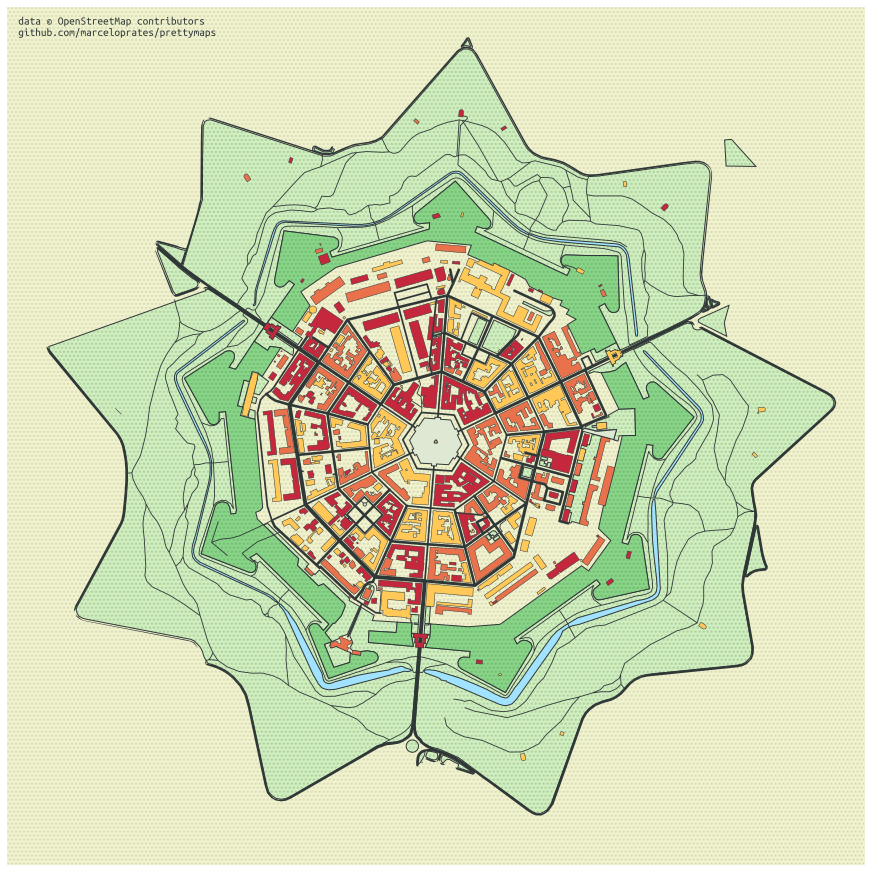

In [8]:
palette = ['#FFC857', '#E9724C', '#C5283D']

fig, ax = plt.subplots(figsize = (12, 12), constrained_layout = True)

def postprocessing(layers):
    boundary = Polygon(layers['green'].buffer(5)[0].exterior).buffer(0)
    layers['building'] = layers['building'].buffer(0).intersection(boundary)
    layers['streets'] = layers['streets'].buffer(0).intersection(boundary)
    return layers

layers = plot(
    'Palmanova, Italy', radius = 970,
    
    ax = ax,

    postprocessing = postprocessing,
    
    layers = {
            'perimeter': {},
            'streets': {
                'width': {
                    'motorway': 5,
                    'trunk': 5,
                    'primary': 4.5,
                    'secondary': 4,
                    'tertiary': 3.5,
                    'residential': 3,
                    'service': 2,
                    'unclassified': 2,
                    'pedestrian': 2,
                    'footway': 1,
                    'track': 1,
                    'bridleway': 1
                }
            },
            'building': {'tags': {'building': True, 'landuse': 'construction'}, 'union': False},
            'water': {'tags': {'natural': ['water', 'bay']}},
            'green': {'tags': {'landuse': 'grass', 'natural': ['island', 'wood'], 'leisure': 'park'}},
            'scrub': {'tags': {'natural': 'scrub'}},
            'walls': {'tags': {'historic': 'citywalls'}},
            'pedestrian_way': {'tags': {'highway': 'pedestrian'}},
        },
        drawing_kwargs = {
            'background': {'fc': '#F2F4CB', 'ec': '#dadbc1', 'hatch': 'ooo...', 'zorder': -1},
            'perimeter': {'fc': '#F2F4CB', 'ec': '#dadbc1', 'lw': 0, 'hatch': 'ooo...',  'zorder': 0},
            'green': {'fc': '#D0F1BF', 'ec': '#2F3737', 'hatch_c': '#b3cfa5', 'hatch': 'ooo...', 'lw': 1, 'zorder': 1},
            'scrub': {'fc': '#89d689', 'ec': '#2F3737', 'hatch_c': '#75bd75', 'hatch': 'ooo...', 'lw': 1, 'zorder': 1},
            'water': {'fc': '#a1e3ff', 'ec': '#2F3737', 'lw': 1, 'zorder': 2},
            'streets': {'fc': '#2F3737', 'ec': '#475657', 'alpha': 1, 'lw': 0, 'zorder': 3},
            'walls': {'fc': '#2F3737', 'ec': '#475657', 'alpha': 1, 'lw': 0, 'zorder': 3},
            'building': {'palette': palette, 'ec': '#2F3737', 'lw': .5, 'zorder': 4},
            'pedestrian_way': {'fc': '#dfe8d3', 'ec': '#2F3737', 'lw': 1, 'zorder': 4},
        },

        osm_credit = {'color': '#2F3737'}
)

#plt.savefig('../prints/palmanova.png')
#plt.savefig('../prints/palmanova.svg')

# Erbil, Iraq (circle plot)

In [9]:
palette = ['#FFC857', '#E9724C', '#C5283D']

fig, ax = plt.subplots(figsize = (12, 12), constrained_layout = True)

layers = plot(
    'Erbil, Iraq', radius = 1500,
    
    ax = ax,
    
    layers = {
            'perimeter': {},
            'streets': {
                'width': {
                    'motorway': 5,
                    'trunk': 5,
                    'primary': 4.5,
                    'secondary': 4,
                    'tertiary': 3.5,
                    'residential': 3,
                    'living_street': 2,
                    'pedestrian': 1,
                    'footway': 1,
                    'track': 1,
                    'bridleway': 1
                }
            },
            'building': {'tags': {'building': True, 'landuse': 'construction'}, 'union': False},
            'water': {'tags': {'natural': ['water', 'bay']}},
            'green': {'tags': {'landuse': 'grass', 'natural': ['island', 'wood'], 'leisure': 'park'}},
            'scrub': {'tags': {'natural': 'scrub'}},
            'walls': {'tags': {'manmade': 'embankment'}},
        },
        drawing_kwargs = {
            'background': {'fc': '#F2F4CB', 'ec': '#dadbc1', 'hatch': 'ooo...', 'zorder': -1},
            'perimeter': {'fc': '#F2F4CB', 'ec': '#dadbc1', 'lw': 0, 'hatch': 'ooo...',  'zorder': 0},
            'green': {'fc': '#D0F1BF', 'ec': '#2F3737', 'hatch_c': '#b3cfa5', 'hatch': 'ooo...', 'lw': 1, 'zorder': 1},
            'scrub': {'fc': '#89d689', 'ec': '#2F3737', 'hatch_c': '#75bd75', 'hatch': 'ooo...', 'lw': 1, 'zorder': 1},
            'water': {'fc': '#a1e3ff', 'ec': '#2F3737', 'lw': 1, 'zorder': 2},
            'streets': {'fc': '#2F3737', 'ec': '#475657', 'alpha': 1, 'lw': 0, 'zorder': 3},
            'walls': {'fc': '#2F3737', 'ec': '#475657', 'alpha': 1, 'lw': 0, 'zorder': 3},
            'building': {'palette': palette, 'ec': '#2F3737', 'lw': .5, 'zorder': 4},
        },

        osm_credit = {'color': '#2F3737'}
)

#plt.savefig('../prints/erbil.png')
#plt.savefig('../prints/erbil.svg')

/home/marcelo/anaconda3/envs/prettymaps/lib/python3.9/site-packages/geopandas/_vectorized.py:142: DeprecationWarning: An exception was ignored while fetching the attribute `__array_interface__` from an object of type 'MultiPolygon'.  With the exception of `AttributeError` NumPy will always raise this exception in the future.  Raise this deprecation warning to see the original exception. (Warning added NumPy 1.21)
  aout[:] = out
/home/marcelo/anaconda3/envs/prettymaps/lib/python3.9/site-packages/geopandas/_vectorized.py:287: DeprecationWarning: An exception was ignored while fetching the attribute `__array_interface__` from an object of type 'MultiLineString'.  With the exception of `AttributeError` NumPy will always raise this exception in the future.  Raise this deprecation warning to see the original exception. (Warning added NumPy 1.21)
  data[:] = [
/home/marcelo/anaconda3/envs/prettymaps/lib/python3.9/site-packages/geopandas/_vectorized.py:142: DeprecationWarning: An exception wa

# Centro, Porto Alegre, Brazil (boundary defined by geography with postprocessing step)

In [10]:
def postprocessing(layers):
    layers['perimeter'] = layers['perimeter'].buffer(10)
    return layers

fig, ax = plt.subplots(figsize = (15, 12), constrained_layout = True)

layers = plot(
    'Centro Histórico, Porto Alegre',
    
    ax = ax,
    
    postprocessing = postprocessing,

    layers = {
            'perimeter': {},
            'streets': {
                'width': {
                    #'motorway': 8,
                    'trunk': 6,
                    'primary': 6,
                    'secondary': 5,
                    'tertiary': 4,
                    'residential': 3,
                    #'living_street': 3,
                    'pedestrian': 1.5,
                    'footway': 1.5,
                    #'track': 1,
                    #'bridleway': 1
                }
            },
            'building': {'tags': {'building': True}, 'union': False},
            'water': {'tags': {'natural': ['water', 'bay']}},
            'green': {'tags': {'landuse': 'grass', 'natural': ['island', 'wood'], 'leisure': 'park'}},
        },
        drawing_kwargs = {
            'background': {'fc': '#F7F3F5', 'ec': '#EFE7EB', 'hatch': 'ooo...', 'zorder': -1},
            'perimeter': {'fc': '#F7F3F5', 'ec': '#2F3737', 'lw': 3, 'hatch': 'ooo...', 'hatch_c': '#EFE7EB',  'zorder': 0},
            'green': {'fc': '#AABD8C', 'ec': '#2F3737', 'hatch_c': '#b3cfa5', 'hatch': 'ooo...', 'lw': 0, 'zorder': 1},
            'water': {'fc': '#a1e3ff', 'hatch': 'ooo...', 'hatch_c': '#80bed9', 'lw': 0, 'zorder': 2},
            'streets': {'fc': '#3b4545', 'lw': 0, 'zorder': 3},
            'building': {'palette': ['#433633', '#FF5E5B'], 'ec': '#2F3737', 'hatch': 'ooo...', 'hatch_c': '#b3504f', 'lw': 0, 'zorder': 4},
        },

        osm_credit = {'color': '#3b4545'}
)

#plt.savefig('../prints/centro-poa.png')
#plt.savefig('../prints/centro-poa.svg')

/home/marcelo/anaconda3/envs/prettymaps/lib/python3.9/site-packages/geopandas/_vectorized.py:287: DeprecationWarning: An exception was ignored while fetching the attribute `__array_interface__` from an object of type 'Polygon'.  With the exception of `AttributeError` NumPy will always raise this exception in the future.  Raise this deprecation warning to see the original exception. (Warning added NumPy 1.21)
  data[:] = [
/home/marcelo/anaconda3/envs/prettymaps/lib/python3.9/site-packages/geopandas/_vectorized.py:287: DeprecationWarning: An exception was ignored while fetching the attribute `__array_interface__` from an object of type 'MultiPolygon'.  With the exception of `AttributeError` NumPy will always raise this exception in the future.  Raise this deprecation warning to see the original exception. (Warning added NumPy 1.21)
  data[:] = [
/home/marcelo/anaconda3/envs/prettymaps/lib/python3.9/site-packages/geopandas/_vectorized.py:142: DeprecationWarning: An exception was ignored 

# (Bom Fim & Farroupilha & Cidade Baixa), Porto Alegre, Brazil (multiple adjacent plots)

/home/marcelo/anaconda3/envs/prettymaps/lib/python3.9/site-packages/geopandas/_vectorized.py:287: DeprecationWarning: An exception was ignored while fetching the attribute `__array_interface__` from an object of type 'Polygon'.  With the exception of `AttributeError` NumPy will always raise this exception in the future.  Raise this deprecation warning to see the original exception. (Warning added NumPy 1.21)
  data[:] = [
/home/marcelo/anaconda3/envs/prettymaps/lib/python3.9/site-packages/geopandas/_vectorized.py:142: DeprecationWarning: An exception was ignored while fetching the attribute `__array_interface__` from an object of type 'Polygon'.  With the exception of `AttributeError` NumPy will always raise this exception in the future.  Raise this deprecation warning to see the original exception. (Warning added NumPy 1.21)
  aout[:] = out
/home/marcelo/anaconda3/envs/prettymaps/lib/python3.9/site-packages/geopandas/_vectorized.py:786: DeprecationWarning: An exception was ignored whi

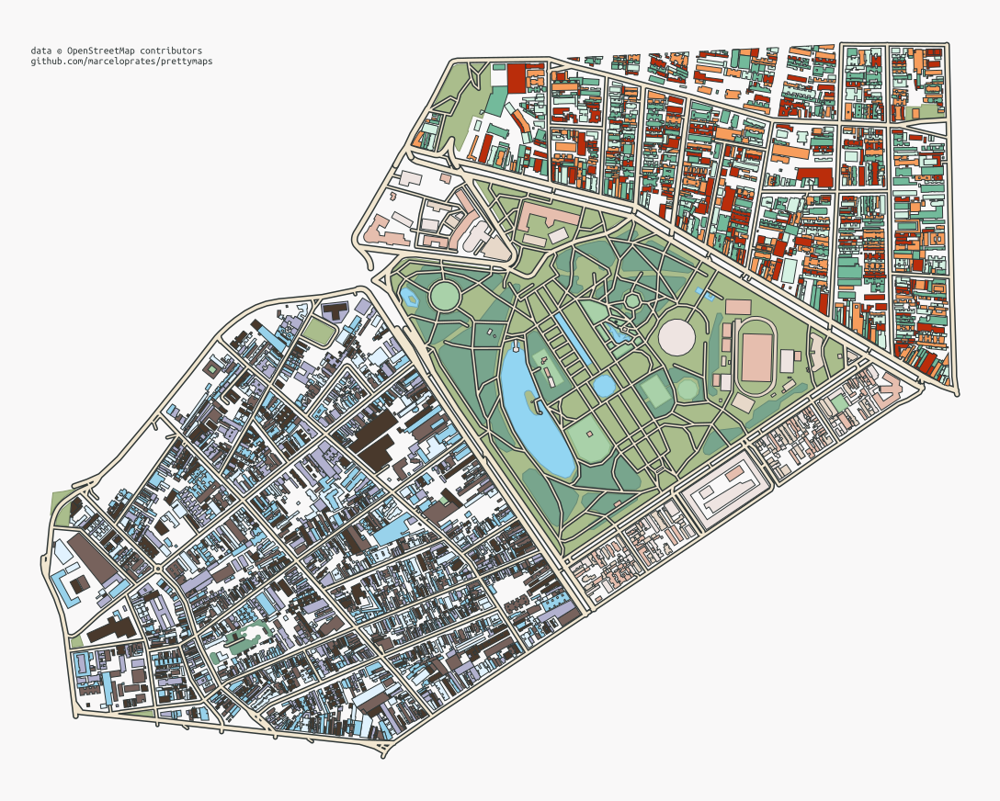

In [11]:
fig, ax = plt.subplots(figsize = (15, 12), constrained_layout = True)
fig.patch.set_facecolor('#F9F8F8')

places = {
    'Farroupilha, Porto Alegre': ['#EEE4E1', '#E7D8C9', '#E6BEAE'],
    'Cidade Baixa, Porto Alegre': ['#49392C', '#77625C', '#B2B1CF', '#E1F2FE', '#98D2EB'],
    'Bom Fim, Porto Alegre': ['#BA2D0B', '#D5F2E3', '#73BA9B', '#F79D5C'],
}

for i, (place, palette) in enumerate(places.items()):
    plot(
        place,
        
        ax = ax,

        layers = {
            'perimeter': {},
            'streets': {
                'width': {
                    'trunk': 6,
                    'primary': 6,
                    'secondary': 5,
                    'tertiary': 4,
                    'residential': 3.5,
                    'pedestrian': 3,
                    'footway': 3,
                    'path': 3,
                }
            },
            'building': {'tags': {'building': True, 'leisure': ['track', 'pitch']}, 'union': False},
            'water': {'tags': {'natural': ['water', 'bay']}},
            'park': {'tags': {'leisure': 'park'}},
            'forest': {'tags': {'landuse': 'forest'}},
            'garden': {'tags': {'leisure': 'garden'}},
        },
        drawing_kwargs = {
            'perimeter': {'fill': False, 'lw': 0, 'zorder': 0},
            'park': {'fc': '#AABD8C', 'ec': '#87996b', 'lw': 1, 'zorder': 1},
            'forest': {'fc': '#78A58D', 'ec': '#658a76', 'lw': 1, 'zorder': 1},
            'garden': {'fc': '#a9d1a9', 'ec': '#8ab58a', 'lw': 1, 'zorder': 1},
            'water': {'fc': '#92D5F2', 'ec': '#6da8c2', 'lw': 1, 'zorder': 2},
            'streets': {'fc': '#F1E6D0', 'ec': '#2F3737', 'lw': 1.5, 'zorder': 3},
            'building': {'palette': palette, 'ec': '#2F3737', 'lw': 1, 'zorder': 4},
        },

        osm_credit = {'x': -.55, 'y': -.25, 'color': '#2F3737'} if i == 0 else None
    )

ax.autoscale()

#plt.savefig('../prints/bomfim-farroupilha-cidadebaixa.png')
#plt.savefig('../prints/bomfim-farroupilha-cidadebaixa.svg')

# Lagoa dos Patos (fetch geography by OpenStreetMap Id)

/home/marcelo/anaconda3/envs/prettymaps/lib/python3.9/site-packages/geopandas/_vectorized.py:287: DeprecationWarning: An exception was ignored while fetching the attribute `__array_interface__` from an object of type 'MultiLineString'.  With the exception of `AttributeError` NumPy will always raise this exception in the future.  Raise this deprecation warning to see the original exception. (Warning added NumPy 1.21)
  data[:] = [
/home/marcelo/anaconda3/envs/prettymaps/lib/python3.9/site-packages/geopandas/_vectorized.py:287: DeprecationWarning: An exception was ignored while fetching the attribute `__array_interface__` from an object of type 'Polygon'.  With the exception of `AttributeError` NumPy will always raise this exception in the future.  Raise this deprecation warning to see the original exception. (Warning added NumPy 1.21)
  data[:] = [
/home/marcelo/anaconda3/envs/prettymaps/lib/python3.9/site-packages/geopandas/_vectorized.py:287: DeprecationWarning: An exception was ignor

(-3563911.8989511337, -3352112.188409847)

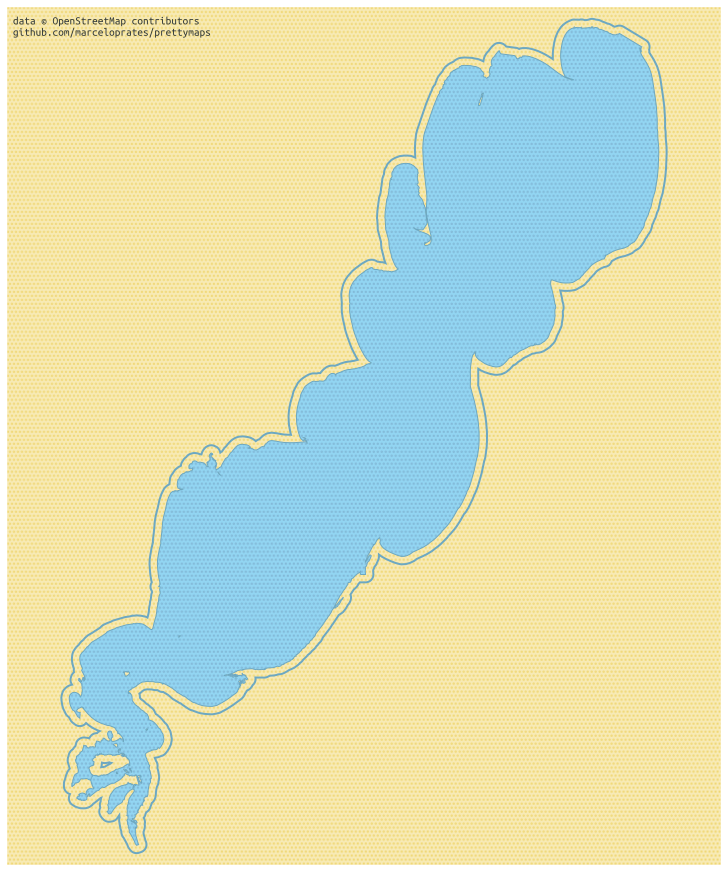

In [2]:
fig, ax = plt.subplots(figsize = (10, 12), constrained_layout = True)

def postprocessing(layers):
    layers['perimeter'] = layers['perimeter'].buffer(2000)
    return layers

layers = plot(
    'R2709093',
    
    ax = ax,

    postprocessing = postprocessing,

    layers = {
        'perimeter': {},
        'water': {'tags': {'natural': ['water']}},
    },
    drawing_kwargs = {
        'background': {'fc': '#F7EAB5', 'ec': '#F1DA7E', 'hatch': 'ooo...'},
        'perimeter': {'fill': False, 'ec': '#6da8c2', 'lw': 2, 'zorder': 3},
        'water': {'fc': '#92D5F2', 'ec': '#6da8c2', 'hatch_c': '#84BCDA', 'hatch': 'ooo...', 'lw': 1, 'zorder': 2},
    },
    
    osm_credit = {'x': -.08, 'y': .02, 'color': '#2F3737'}
)

# Set bounds
xmin, xmax = ax.get_xlim()
ymin, ymax = ax.get_ylim()
dx, dy = xmax-xmin, ymax-ymin
ax.set_xlim(xmin+.15*dx, xmax-.15*dx)
ax.set_ylim(ymin+.0*dy, ymax-.0*dy)